# Imports

In [1]:
!pip install sklearn-crfsuite
!pip install git+https://github.com/lucasb-eyer/pydensecrf

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 12.0 MB/s eta 0:00:00
  Cloning https://github.com/lucasb-eyer/pydensecrf to /tmp/pip-req-build-zgtontqs
  Running command git clone --filter=blob:none --quiet https://github.com/lucasb-eyer/pydensecrf /tmp/pip-req-build-zgtontqs
  Resolved https://github.com/lucasb-eyer/pydensecrf to commit 2723c7fa4f2ead16ae1ce3d8afe977724bb8f87f
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pydensecrf: filename=pydensecrf-1.0-cp310-cp310-linux_x86_64.whl size=3405179 sha256=644a6854e61184a0f46e8581c27db1e419726d271a530c6a190e4cbd39c0a187
  Stored in directory: /tmp/pip-ephem-wheel-cache-yxwkla0p/wheels/69/91/53/f7b05b0969c8ca25b5c83aa879c06306db3b06a207396d679a
Successfully built pydensecrf


In [2]:
import os
import cv2

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from PIL import Image
from tqdm.auto import tqdm
from google.colab import drive
from sklearn_crfsuite import CRF
from skimage.color import label2rgb
from pydensecrf import densecrf as dcrf
from skimage.segmentation import slic, mark_boundaries
from pydensecrf.utils import unary_from_labels, create_pairwise_gaussian, create_pairwise_bilateral

# Connecting to the Google Drive Shortcuts


Before you run the cells bellow, make sure to make a google drive short cut to the [DBL Google Drive](https://drive.google.com/drive/u/0/folders/1JWr9SORKKmUjwQFYigekfVXpHwfEqNss)

In [3]:
ROOT_PATH = '/content/drive/MyDrive/jbg060_AI_for_Good_course_Shared'
drive.mount('/content/drive')

Mounted at /content/drive


# Global variables

In [4]:
# Original data and annotations path
DATA_BASE_PATH = os.path.join(ROOT_PATH, '01_Data', 'benthic_datasets', 'point_labels', 'SEAVIEW')
ANNOTATIONS_PATH = os.path.join(DATA_BASE_PATH, 'tabular-data')

In [5]:
REGIONS = {
    1: 'ATL', 2: 'IND_CHA', 3: 'IND_MDV', 4: 'PAC_AUS', 5: 'PAC_USA',
    6: 'PAC_IDN_PHL', 7: 'PAC_SLB', 8: 'PAC_TWN', 9: 'PAC_TLS',
    }
IMAGE_COUNTS = {
    1: 1407, 2: 686, 3: 1612, 4: 2657, 5: 1153,
    6: 1638, 7: 732, 8: 638, 9: 864,
    }
POINT_COUNTS = {
    1: 92900, 2: 52450, 3: 144100, 4: 186420, 5: 83100,
    6: 120100, 7: 59200, 8: 50000, 9: 71600,
    }

In [6]:
# initialize a data frame to hold the annotations across all regions
ANNOTATIONS_DF = pd.DataFrame()

# read individual region specific annotations file and append to main data frame
# region speicific annotation files contain additional useful columns

# loop through the list of regions
for region in tqdm(REGIONS.values(), total=len(REGIONS)):

    # read region specific annotation file
    region_wise_annotations_df = \
        pd.read_csv(
            os.path.join(ANNOTATIONS_PATH, f"annotations_{region}.csv"),
            header='infer',
        )

    # assign region name under to which image files belong to
    region_wise_annotations_df['region'] = region

    # append to main annotations data frame
    ANNOTATIONS_DF = \
        pd.concat(
            [ANNOTATIONS_DF, region_wise_annotations_df],
            ignore_index=True,
            )

ANNOTATIONS_DF['func_group_alt'] = \
    [func_group if func_group in ('Hard Coral', 'Soft Coral') else 'Others'
     for func_group in ANNOTATIONS_DF.func_group]

region_wise_annotations_df.head()

  0%|          | 0/9 [00:00<?, ?it/s]

,quadratid,y,x,label_name,label,func_group,method,data_set,region
0,30002121501,83,85,Loose Substrate: Sand,LSUB_SAND,Other,random,train,PAC_TLS
1,30002121501,93,319,Loose Substrate: Sand,LSUB_SAND,Other,random,test,PAC_TLS
2,30002121501,128,457,Other soft-corals no common Alcyoniidae and er...,SINV_SFC_O,Soft Coral,random,test,PAC_TLS
3,30002121501,245,578,Other soft-corals no common Alcyoniidae and er...,SINV_SFC_O,Soft Coral,random,test,PAC_TLS
4,30002121501,163,670,Other soft-corals no common Alcyoniidae and er...,SINV_SFC_O,Soft Coral,random,test,PAC_TLS


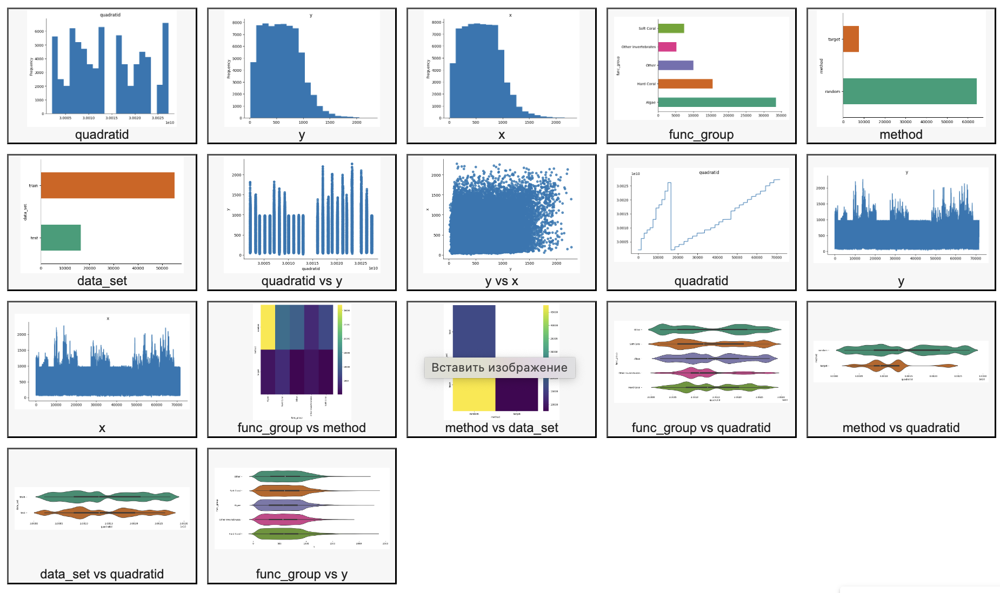

In [7]:
ANNOTATIONS_DF.head()

,quadratid,y,x,label_name,label,func_group,method,data_set,region,func_group_alt
0,17001738002,180,183,Fish,FISH,Other,random,test,ATL,Others
1,17001738002,199,162,CCA,CCA,Algae,random,test,ATL,Others
2,17001738002,197,160,CCA,CCA,Algae,random,test,ATL,Others
3,17001738002,88,561,Turf,Turf,Algae,random,test,ATL,Others
4,17001738002,195,714,Ocomplex,OCOM,Hard Coral,random,test,ATL,Hard Coral


In [8]:
sum_unique_quadrats = 0
all_image_files = []
for key, folder in REGIONS.items():
    image_files = os.listdir(os.path.join(DATA_BASE_PATH, folder))
    annotation_quadrats = set(ANNOTATIONS_DF.query(f"region == '{folder}'")\
                                            .quadratid\
                                            .astype('str')\
                                            +'.jpg')
    sum_unique_quadrats += len(annotation_quadrats)
    all_image_files = set(all_image_files) | set(image_files)

    print("-"*80)
    print(f"{folder}: ")
    print(f"\t # of Image Files = {len(image_files)}")
    print(f"\t # of Unique Image Files = {len(set(image_files))}")
    print(f"\t # of Unique Quadrats in Annotations = {len(annotation_quadrats)}")
    print(f"\t # of Images as per Dataset Summary = {IMAGE_COUNTS[key]}")
    print(f"\t Intersection of Folder & Annotations = {len(set(image_files) & annotation_quadrats)}")
    print(f"\t Annotations MINUS Folder = {len(annotation_quadrats - set(image_files))}, {annotation_quadrats - set(image_files)}")
    print(f"\t Folder MINUS Annotations = {len(set(image_files) - annotation_quadrats)}, {set(image_files) - annotation_quadrats}")

print("-"*80)

print(f"# of Unique Quadrat IDs across regions = {ANNOTATIONS_DF.quadratid.nunique()}")
print(f"# of Unique Quadrat IDs across all folder = {len(all_image_files)}")
print(f"Sum of Unique Quadrat IDs within each folder = {sum_unique_quadrats}")

for key, folder in REGIONS.items():
    annotations_count = ANNOTATIONS_DF.query(f"region == '{folder}'").shape[0]

    # Unique count based on ['quadratid', 'x', 'y']
    unique_count_1 = ANNOTATIONS_DF.query(f"region == '{folder}'")\
                                   .groupby(['quadratid', 'x', 'y'])\
                                   .size()\
                                   .reset_index(name='count')\
                                   .query('count == 1')\
                                   ['count']\
                                   .count()

    # Unique count based on ['quadratid', 'x', 'y', 'label']
    unique_count_2 = ANNOTATIONS_DF.query(f"region == '{folder}'")\
                                   .groupby(['quadratid', 'x', 'y', 'label'])\
                                   .size()\
                                   .reset_index(name='count')\
                                   .query('count == 1')\
                                   ['count']\
                                   .count()

    # Print the results
    print("-"*80)
    print(f"{folder}: ")
    print(f"\t # of Points in Summary = {POINT_COUNTS[key]}")
    print(f"\t # of Points in Annotations File = {annotations_count}")
    print(f"\t # of Unique Points (Quadrat ID, X, Y) = {unique_count_1}")
    print(f"\t # of Unique Points (Quadrat ID, X, Y, Label) = {unique_count_2}")
    print(f"\t # of Contradictory Annotations for Same Point = {unique_count_2 - unique_count_1}")

print("-"*80)

--------------------------------------------------------------------------------
ATL: 
	 # of Image Files = 1407
	 # of Unique Image Files = 1407
	 # of Unique Quadrats in Annotations = 1407
	 # of Images as per Dataset Summary = 1407
	 Intersection of Folder & Annotations = 1407
	 Annotations MINUS Folder = 0, set()
	 Folder MINUS Annotations = 0, set()
--------------------------------------------------------------------------------
IND_CHA: 
	 # of Image Files = 686
	 # of Unique Image Files = 686
	 # of Unique Quadrats in Annotations = 686
	 # of Images as per Dataset Summary = 686
	 Intersection of Folder & Annotations = 686
	 Annotations MINUS Folder = 0, set()
	 Folder MINUS Annotations = 0, set()
--------------------------------------------------------------------------------
IND_MDV: 
	 # of Image Files = 1612
	 # of Unique Image Files = 1612
	 # of Unique Quadrats in Annotations = 1612
	 # of Images as per Dataset Summary = 1612
	 Intersection of Folder & Annotations = 1612
	 

In [9]:
ANNOTATIONS_DF

,quadratid,y,x,label_name,label,func_group,method,data_set,region,func_group_alt
0,17001738002,180,183,Fish,FISH,Other,random,test,ATL,Others
1,17001738002,199,162,CCA,CCA,Algae,random,test,ATL,Others
2,17001738002,197,160,CCA,CCA,Algae,random,test,ATL,Others
3,17001738002,88,561,Turf,Turf,Algae,random,test,ATL,Others
4,17001738002,195,714,Ocomplex,OCOM,Hard Coral,random,test,ATL,Hard Coral
...,...,...,...,...,...,...,...,...,...,...
859865,30027261001,910,700,Epilithic algal matirx smotheting rubble,EAM_RB,Algae,random,train,PAC_TLS,Others
859866,30027261001,905,933,Epilithic algal matirx smotheting rubble,EAM_RB,Algae,random,train,PAC_TLS,Others
859867,30027261001,930,876,Epilithic algal matirx smotheting rubble,EAM_RB,Algae,random,train,PAC_TLS,Others
859868,30027261001,826,884,Epilithic algal matirx smotheting rubble,EAM_RB,Algae,random,train,PAC_TLS,Others


## Train Test Leakage Check

### Train Test Leakage Candidates

In order to avoid train-test leakage, it is important to ensure that the same image (photoquadrat) is not used in both train and test datasets.

In [10]:
ANNOTATIONS_DF\
    .groupby(['region', 'quadratid'])\
    .agg(DataSetUniqueCount=('data_set', 'nunique'))\
    .reset_index()\
    .query("DataSetUniqueCount > 1")\
    .groupby(['region'])\
    .agg(quadrat_count=('quadratid', 'count'))\
    .reset_index()

,region,quadrat_count
0,ATL,2
1,IND_CHA,4
2,IND_MDV,53
3,PAC_AUS,3
4,PAC_IDN_PHL,13
5,PAC_SLB,7
6,PAC_TLS,14
7,PAC_TWN,12
8,PAC_USA,8


In [11]:
ANNOTATIONS_DF\
    .groupby(['quadratid', 'region', 'data_set'])\
    .agg(PointsCount=('quadratid', 'count'))\
    .reset_index()\
    .query(
        "quadratid == 24044096401"
    )

,quadratid,region,data_set,PointsCount
3061,24044096401,ATL,test,50
3062,24044096401,ATL,train,100


In [12]:
train_test_leakage_candidates = \
    ANNOTATIONS_DF\
        .groupby(['quadratid'])\
        .agg(DataSetUniqueCount=('data_set', 'nunique'))\
        .reset_index()\
        .query("DataSetUniqueCount > 1")\
        .quadratid.to_list()

### Observations

* There is a possibility of train-test leakage in 116 images as some random point annotations belong to train dataset and remaining random point annotations belong to test dataset.
* The issue can be eliminated by excluding these 116 images from all datasets or they can be re-assigned to a single dataset as per below approach.

## Train Test Split - Alternate Criteria

Alternate Approach: Revise the train-test splits based on a different criteria (not recommended though)

### Quadrat ID Format

Each quardratid is 11 digits. The format is as follows:
1. First 5 digits = Survey ID. It is the unique identifier of each reef location in space and time.
2. First 9 digits = Image ID. This corresponds to the five-digit survey ID and four more digits between 0001 and 9999 (number of the picture automatically assigned by the camera). Identical image ID’s will appear multiple times in this field as one image has associated multiple quadrats.
3. Last 2 digits usually between 01 and 09 = Quadrat Number within an image. This is automatically assigned during the cropping process. This would imply that each image acquired by the camera may produce anywhere between 1 - 9 photo-quadrats (each of which cover 1$m^2$ coral/sea substrate footprint).

“.jpg” must be added to the quadrat ID to derive the filename of the quadrat (with the extension) within the imagery.

Hierarchical structure of photo-quadrat dataset is shown in the below figure. A transect refers to a location that can be surveyed multiple times (e.g. in different years). Each survey involves the collection of many images. From each image one or more standardised photo-quadrat images can be extracted.

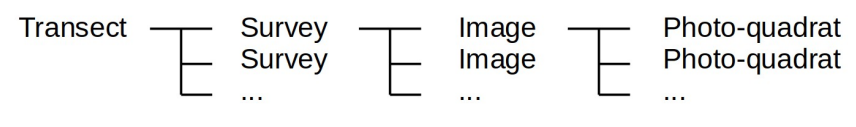

### Test Transect Selection Process

XL Catlin Seaview Survey project team selected testing dataset as a separate set of images from the training dataset to ensure complete independence from the data used to train the network models.

This test dataset was a selection of contiguous images within transects with an extent of 30 m in length, concomitant with most coral reef monitoring programs and best represents the spatial heterogeneity within a site. Therefore, they aggregated the images from the 2 km transects within a standard transect length of 30 m, hereafter called “test transects”. Test transects were selected at random, within the 2 km transects, while ensuring that no test transect contained images used for training the networks [3].

To locate the 30m units (test transects) within the 2km-transects, they used images for all surveyed years in each transect and applied hierarchical clustering with Ward’s method, as implemented in the “hclust” function of R (https://www.mdpi.com/2072-4292/12/3/489/s1). The Ward’s method creates clusters that minimize within-cluster variance in the distance metric (the physical distance among points i.e. images) and cut the cluster at 30m to identify the aggregation groups. From these units, a number
test transects per region were selected at random.

### Selection Criteria from Data

The number of images and points manually annotated per network is presented in https://www.nature.com/articles/s41597-020-00698-6/tables/3. In general, random point annotations were done for about 100 points per photo-quadrat for training sets and 40 or 50 points per photo-quadrat for testing sets [1].

Based on the table referred above, it can be observed that 586,740 annotations were done for 5,801 training photo-quadrats. Moreover, 273,130 annotations were done for 5,747 photo-quadrats from 517 test transects. The average annotations per quadrat for training and test sets are 101.14 and 47.53 respectively.

**Possible Criteria:**

* Quadrats that contain 50 annotation points or less = test set
* Quadrats that contain at least 100 annotation points = training sets

Histogram showing the distribution of # of random point annotations per photoquadrat (image)

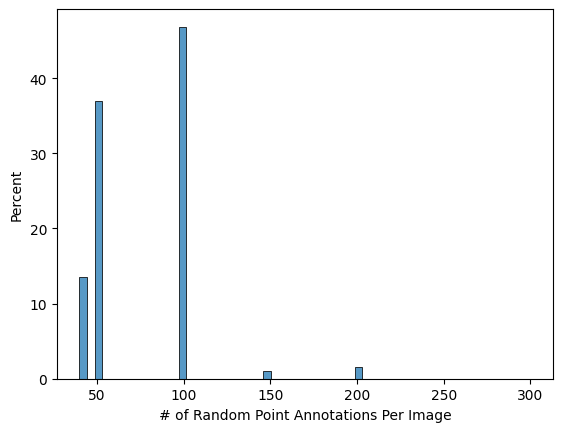

In [13]:
sns.histplot(
    data=ANNOTATIONS_DF\
            .groupby('quadratid')\
            .agg(points_count=('quadratid', 'count'))\
            .reset_index(),
    x='points_count',
    stat='percent',
    )
plt.xlabel("# of Random Point Annotations Per Image")
plt.show()

Frequency table for # of random point annotations per photoquadrat (image)

In [14]:
ANNOTATIONS_DF\
    .groupby(['quadratid'])\
    .agg(points_count=('quadratid', 'count'))\
    .reset_index()\
    .groupby(['points_count'])\
    .count()\
    .reset_index()

,points_count,quadratid
0,40,1543
1,50,4209
2,80,1
3,100,5336
4,140,3
5,150,111
6,200,182
7,250,1
8,300,1


Region wise frequencies for # of random point annotations per photoquadrat (image)

In [15]:
ANNOTATIONS_DF\
    .groupby(['quadratid', 'region'])\
    .agg(points_count=('quadratid', 'count'))\
    .reset_index()\
    .groupby(['region', 'points_count'])\
    .agg(quadrats=('quadratid', 'count'))

quadrats
region      points_count          
ATL         50                 958
            100                447
            150                  2
IND_CHA     50                 327
            100                355
            150                  4
IND_MDV     50                 487
            100               1028
            150                 52
            200                 43
            250                  1
            300                  1
PAC_AUS     40                1543
            80                   1
            100                978
            140                  3
            200                132
PAC_IDN_PHL 50                 887
            100                738
            150                 13
PAC_SLB     50                 293
            100                429
            150                  7
            200                  3
PAC_TLS     50                 317
            100                530
            150                 13
            200                  4
PAC_TWN     50                 288
            100                338
            150                 12
PAC_USA     50                 652
            100                493
            150                  8

Check points_count pattern before excluding train-test leakage candidates

In [16]:
ANNOTATIONS_DF\
    .groupby(['quadratid', 'region', 'data_set'])\
    .agg(points_count=('quadratid', 'count'))\
    .reset_index()\
    .groupby(['region', 'data_set', 'points_count'])\
    .count()

quadratid
region      data_set points_count           
ATL         test     50                  960
            train    100                 449
IND_CHA     test     50                  331
            train    100                 359
IND_MDV     test     50                  540
            train    100                1080
                     200                  44
                     300                   1
PAC_AUS     test     40                 1425
                     80                    1
            train    40                  121
                     100                 981
                     200                 132
PAC_IDN_PHL test     50                  900
            train    100                 751
PAC_SLB     test     50                  300
            train    100                 436
                     200                   3
PAC_TLS     test     49                    1
                     50                  329
            train    1                     1
                     100                 543
                     200                   4
PAC_TWN     test     50                  300
            train    100                 350
PAC_USA     test     50                  660
            train    100                 501

Check points_count pattern after excluding train-test leakage candidates

In [17]:
ANNOTATIONS_DF\
    .query(f"~ quadratid.isin({train_test_leakage_candidates})")\
    .groupby(['quadratid', 'region', 'data_set'])\
    .agg(points_count=('quadratid', 'count'))\
    .reset_index()\
    .groupby(['region', 'data_set', 'points_count'])\
    .count()

quadratid
region      data_set points_count           
ATL         test     50                  958
            train    100                 447
IND_CHA     test     50                  327
            train    100                 355
IND_MDV     test     50                  487
            train    100                1028
                     200                  43
                     300                   1
PAC_AUS     test     40                 1422
                     80                    1
            train    40                  121
                     100                 978
                     200                 132
PAC_IDN_PHL test     50                  887
            train    100                 738
PAC_SLB     test     50                  293
            train    100                 429
                     200                   3
PAC_TLS     test     50                  316
            train    100                 530
                     200                   4
PAC_TWN     test     50                  288
            train    100                 338
PAC_USA     test     50                  652
            train    100                 493

### Observations

* Data indicates a clear pattern and it agrees with the description provided in the research paper.
* Quadrats that have 50 or 40 random point annotations can be treated as "Test Dataset".
* Quadrats that have 100 or more random points annotations can be treated as "Training Dataset".
* One quadrat contains 80 random point annotations - this can  be treated as "Training Dataset" or excluded from all datasets.

/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When 

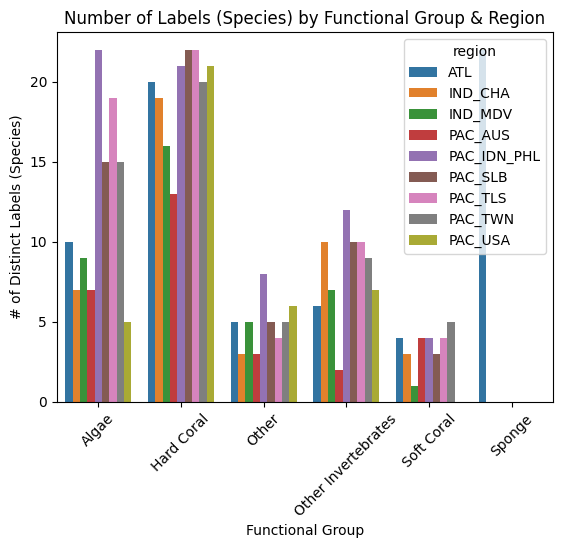

In [18]:
sns.barplot(
    data=ANNOTATIONS_DF\
            .groupby(['region', 'func_group'])\
            .agg(labels_count=('label_name', 'nunique'))\
            .reset_index(),
    x='func_group',
    y='labels_count',
    hue='region',
    )
plt.title("Number of Labels (Species) by Functional Group & Region")
plt.xlabel("Functional Group")
plt.ylabel("# of Distinct Labels (Species)")
plt.xticks(rotation=45)
plt.show()

# Preprocessing Functions

In [28]:
import cv2 as cv
import numpy as np
import os


# img = normalize(img)

def white_balance(img):
    result = cv.cvtColor(img, cv.COLOR_BGR2LAB)
    avg_a = np.average(result[:, :, 1])
    avg_b = np.average(result[:, :, 2])
    result[:, :, 1] = result[:, :, 1] - ((avg_a - 128) * (result[:, :, 0] / 255.0) * 1.1)
    result[:, :, 2] = result[:, :, 2] - ((avg_b - 128) * (result[:, :, 0] / 255.0) * 1.1)
    result = cv.cvtColor(result, cv.COLOR_LAB2BGR)
    return result

def CLAHE(img):
    R, G, B = cv.split(img)
    clahe = cv.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl1_R = clahe.apply(R)
    cl1_G = clahe.apply(G)
    cl1_B = clahe.apply(B)
    cl1 = cv.merge((cl1_R, cl1_G, cl1_B))
    return cl1

def normalize(img):
    img_wb = white_balance(img)
    img_wb_CLAHE = CLAHE(img_wb)
    return img_wb_CLAHE

# Load and View

Quadrat (Image) File Path: /content/drive/MyDrive/jbg060_AI_for_Good_course_Shared/01_Data/benthic_datasets/point_labels/SEAVIEW/ATL/17001652802.jpg


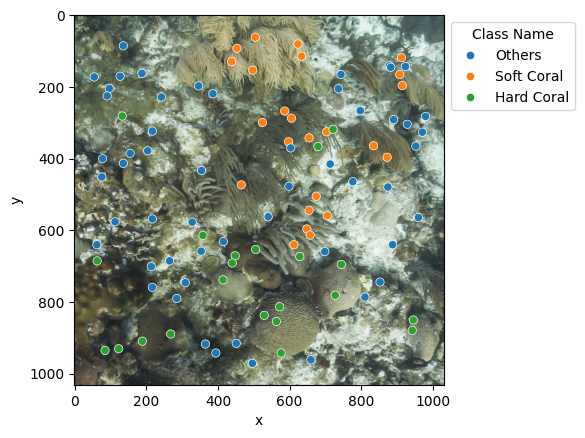

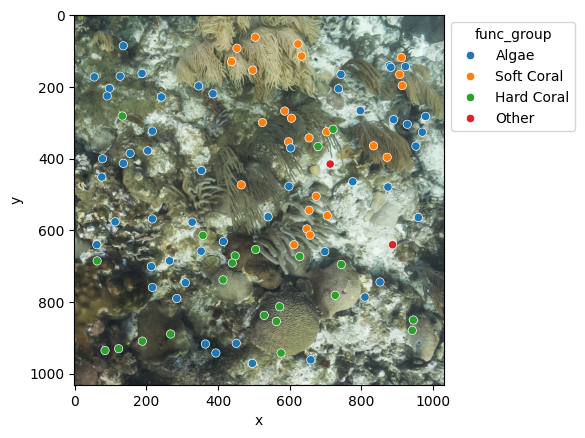

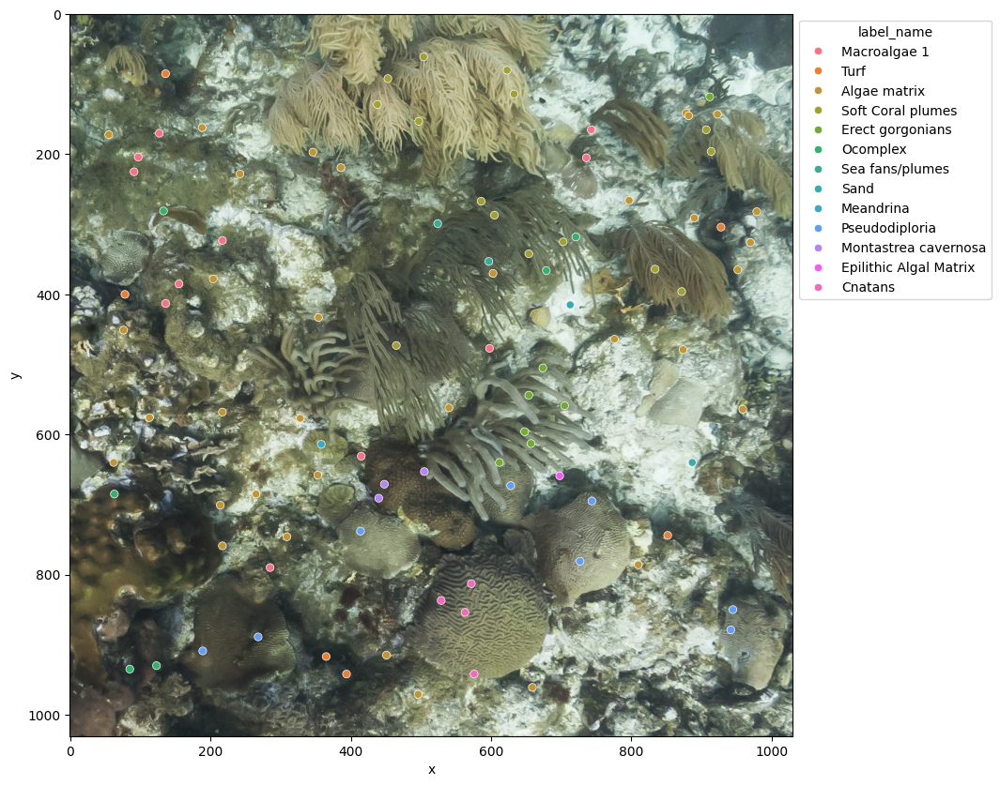

In [19]:
quadrat_id =  17001652802

quadrat_region = \
    ANNOTATIONS_DF[ANNOTATIONS_DF.quadratid == quadrat_id].region.to_list()[0]
quadrat_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")
quadrat_df = \
    ANNOTATIONS_DF\
        .query(f"quadratid == {quadrat_id}")\
        [['x', 'y', 'func_group', 'func_group_alt', 'label', 'label_name', 'data_set', 'method']]

if os.path.exists(quadrat_path):
    print(f"Quadrat (Image) File Path: {quadrat_path}")

quadrat_image = cv2.imread(quadrat_path)
quadrat_image = cv2.cvtColor(quadrat_image, cv2.COLOR_BGR2RGB)

plt.imshow(quadrat_image)
ax = sns.scatterplot(data=quadrat_df, x='x', y='y', hue='func_group_alt')
sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1), title='Class Name')
plt.show()

plt.imshow(quadrat_image)
ax = sns.scatterplot(data=quadrat_df, x='x', y='y', hue='func_group')
sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1))
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(quadrat_image)
ax = sns.scatterplot(data=quadrat_df, x='x', y='y', hue='label_name')
sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1))
plt.show()

# Stage 1 - Preprocessing and Superpixel Segmentation (SLIC)

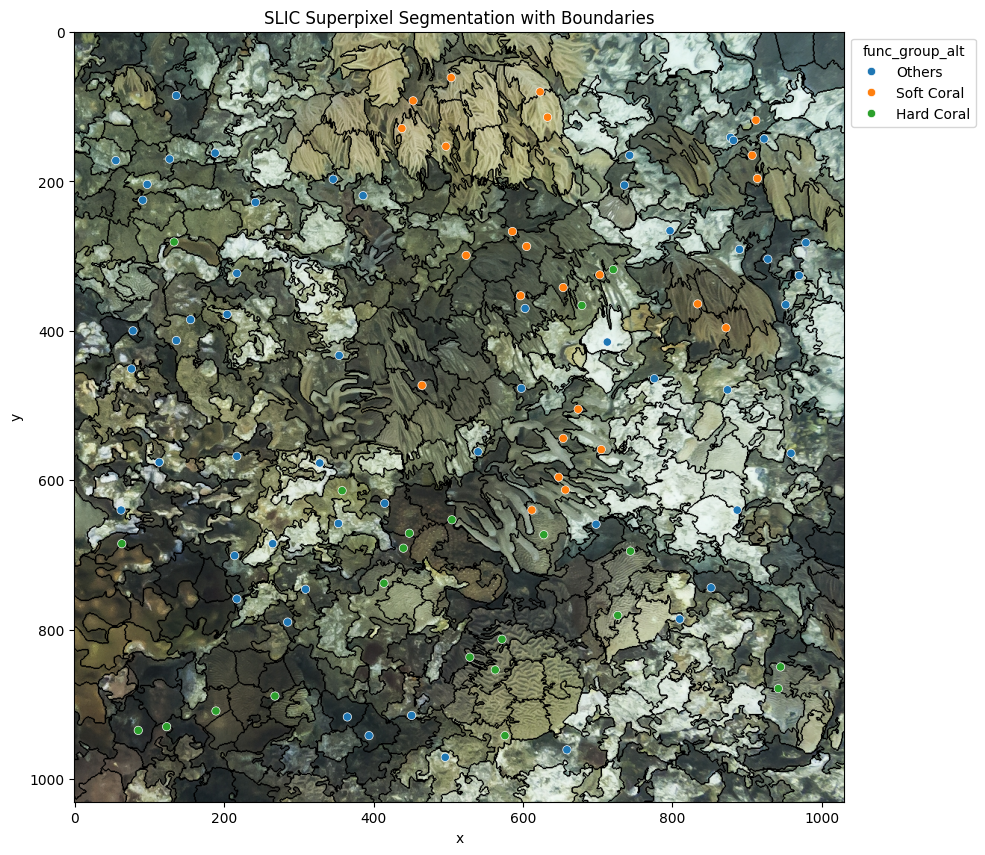

In [20]:
# Load image
image = cv2.imread(os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg"))
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Apply SLIC superpixel segmentation
num_segments = 600  # Number of desired superpixels
segments = slic(image_rgb, n_segments=num_segments, compactness=10, sigma=1)

# Visualize superpixels with boundaries only (no color filling)
segmented_image_with_boundaries = mark_boundaries(image_rgb, segments, color=(0, 0, 0), mode='inner')  # `color` sets the boundary color (white here)

# Plot the image with the superpixel boundaries
plt.figure(figsize=(10, 10))
plt.imshow(segmented_image_with_boundaries)
ax = sns.scatterplot(data=quadrat_df, x='x', y='y', hue='func_group_alt')
sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1))
plt.title('SLIC Superpixel Segmentation with Boundaries')
plt.show()


# Step 2, Sparse Label Propagation after Superpixel Application (dev)

In [21]:
!pip install scikit-image opencv-python

### Superpixels models

In [22]:
from skimage.segmentation import quickshift
from skimage.segmentation import felzenszwalb
from skimage.segmentation import watershed
from skimage.feature import peak_local_max
from scipy import ndimage as ndi
from skimage.filters.rank import entropy
from skimage.filters import rank
from skimage.morphology import disk
from skimage.color import rgb2gray
from skimage.util import img_as_ubyte

def generate_superpixels_felzenszwalb(image, scale=100, sigma=0.5, min_size=50):
    superpixels = felzenszwalb(image, scale=scale, sigma=sigma, min_size=min_size)
    return superpixels


def generate_superpixels_quickshift(image, kernel_size=3, max_dist=6, ratio=0.5):
    superpixels = quickshift(image, kernel_size=kernel_size, max_dist=max_dist, ratio=ratio)
    return superpixels


def generate_superpixels_watershed(image):
    # Convert image to grayscale
    gray_image = rgb2gray(image)

    # Compute gradient using Sobel
    gradient = ndi.sobel(gray_image)

    # Convert grayscale image to int for labels
    gray_image_int = img_as_ubyte(gray_image)

    # Find local maxima as markers using the integer grayscale image
    local_max_coords = peak_local_max(-gradient, min_distance=2, labels=gray_image_int)

    # Create markers array
    markers = np.zeros_like(gradient, dtype=int)
    markers[tuple(local_max_coords.T)] = np.arange(1, len(local_max_coords) + 1)

    # Apply the watershed algorithm
    superpixels = watershed(gradient, markers)

    return superpixels


def generate_superpixels_entropy(image, radius=5):
    # Convert the image to uint8 for rank filters
    gray_image = img_as_ubyte(rgb2gray(image))

    # Compute entropy
    entropy_img = entropy(gray_image, disk(radius))

    # Find peak local maxima coordinates
    local_max_coords = peak_local_max(entropy_img, min_distance=2)

    # Create a mask from the coordinates
    markers = np.zeros_like(entropy_img, dtype=int)
    markers[tuple(local_max_coords.T)] = np.arange(1, len(local_max_coords) + 1)

    # Apply watershed algorithm
    superpixels = watershed(entropy_img, markers)

    return superpixels



### Label propagation techniques

In [23]:
# FUNCTIONS FOR PROPAGATION OF SUPERPIXELS
from sklearn.cluster import MeanShift
from skimage.segmentation import random_walker
from sklearn.cluster import SpectralClustering
from sklearn.neighbors import KNeighborsClassifier
from skimage.color import rgb2gray


def propagate_labels_by_distance(superpixels, superpixel_labels, image):
    centroids = np.array([np.mean(np.argwhere(superpixels == i), axis=0) for i in np.unique(superpixels)])
    distances = np.linalg.norm(centroids[:, np.newaxis] - centroids, axis=2)

    # Set threshold based on distance
    threshold = np.mean(distances)
    rag = graph.rag_mean_color(image, superpixels, mode='distance')
    propagated_labels = graph.cut_threshold(superpixels, rag, threshold)

    return propagated_labels


def propagate_labels_random_walk(superpixels, superpixel_labels, image):
    # Convert image to grayscale to match the label shape
    gray_image = rgb2gray(image)

    # Mark known labels and set unknown labels to -1
    markers = np.copy(superpixel_labels)
    markers[superpixel_labels == 0] = -1  # Treat unknown labels as -1

    # Perform random walker segmentation
    propagated_labels = random_walker(gray_image, markers, beta=10)

    return propagated_labels


def propagate_labels_knn(superpixels, superpixel_labels, image):
    # Calculate centroids for each superpixel
    centroids = np.array([np.mean(np.argwhere(superpixels == i), axis=0) for i in np.unique(superpixels)])

    # Get unique superpixel indices and labels
    unique_superpixels = np.unique(superpixels)
    superpixel_label_map = np.array([superpixel_labels[superpixels == i][0] for i in unique_superpixels])

    # Separate known and unknown labels
    known_labels = unique_superpixels[superpixel_label_map > 0]
    known_centroids = centroids[superpixel_label_map > 0]
    unknown_labels = unique_superpixels[superpixel_label_map == 0]
    unknown_centroids = centroids[superpixel_label_map == 0]

    # Apply KNN classification to propagate labels to unknown superpixels
    knn = KNeighborsClassifier(n_neighbors=3)
    knn.fit(known_centroids, superpixel_label_map[superpixel_label_map > 0])
    predicted_labels = knn.predict(unknown_centroids)

    # Update superpixel_labels with the propagated labels
    for i, label in zip(unknown_labels, predicted_labels):
        superpixel_labels[superpixels == i] = label

    return superpixel_labels


def propagate_labels_mean_shift(superpixels, superpixel_labels, image):
    # Calculate centroids for each superpixel
    centroids = np.array([np.mean(np.argwhere(superpixels == i), axis=0) for i in np.unique(superpixels)])

    # Apply Mean Shift clustering
    mean_shift = MeanShift(bandwidth=20)
    clusters = mean_shift.fit_predict(centroids)

    # Map the clusters back to the superpixels
    for i, cluster in enumerate(clusters):
        mask = superpixels == np.unique(superpixels)[i]
        superpixel_labels[mask] = np.max(superpixel_labels[mask])  # Use majority label within the cluster

    return superpixel_labels


def propagate_labels_spectral(superpixels, superpixel_labels, image):
    # Calculate centroids for each superpixel
    centroids = np.array([np.mean(np.argwhere(superpixels == i), axis=0) for i in np.unique(superpixels)])

    # Perform spectral clustering based on centroids
    num_clusters = len(np.unique(superpixel_labels))
    spectral = SpectralClustering(n_clusters=num_clusters, affinity='nearest_neighbors')
    clusters = spectral.fit_predict(centroids)

    # Assign labels to each superpixel based on clusters
    for i, cluster in enumerate(clusters):
        mask = superpixels == np.unique(superpixels)[i]
        # Set the label of the entire superpixel to the majority label in that cluster
        superpixel_labels[mask] = np.max(superpixel_labels[mask])

    return superpixel_labels


### Pipe

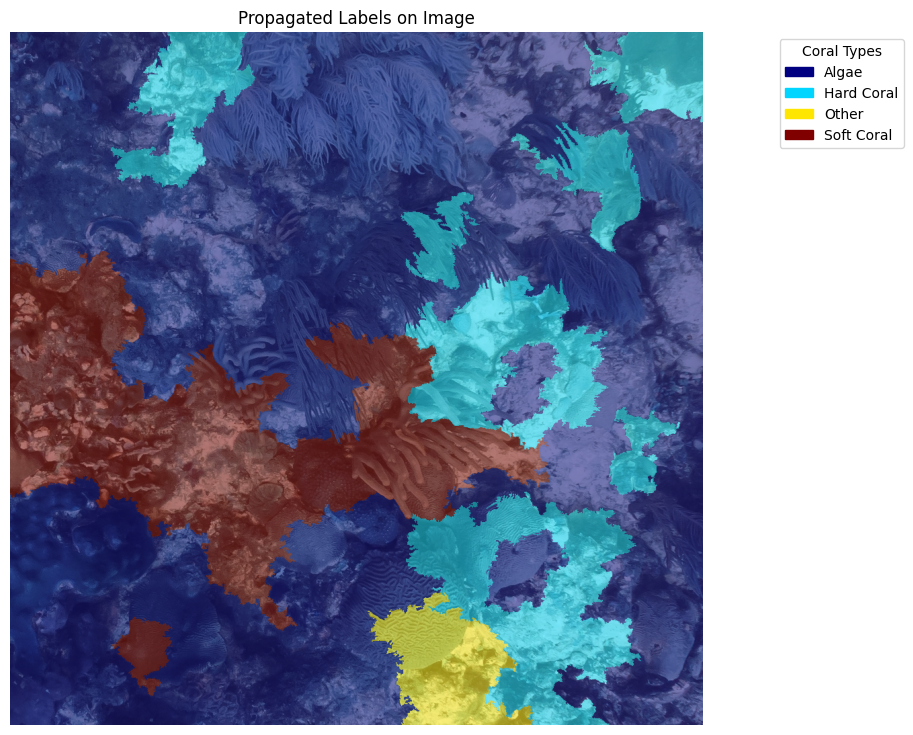

In [24]:
import cv2

import numpy as np
import skimage.graph as graph
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage.color import label2rgb
from skimage.segmentation import slic
from google.colab.patches import cv2_imshow
from sklearn.preprocessing import LabelEncoder

# Step 1: Load Image and Sparse Point Labels
def load_image_and_labels(image_path, point_labels):
    image = cv2.imread(image_path)
    labels = point_labels  # Dictionary: key=coordinates, value=label
    return image, labels

# Step 2: Generate Superpixels using SLIC (Simple Linear Iterative Clustering)
def generate_superpixels(image, n_segments=200):
    superpixels = slic(image, n_segments=n_segments, compactness=10)
    return superpixels

# Step 3: Assign Labels to Superpixels
def assign_labels_to_superpixels(superpixels, labels):
    superpixel_labels = np.zeros_like(superpixels)
    for coord, label in labels.items():
        superpixel = superpixels[coord[0], coord[1]]
        superpixel_labels[superpixels == superpixel] = label
    return superpixel_labels

# Step 4: Label Propagation Using Region Adjacency Graph
def propagate_labels_by_similarity(superpixels, superpixel_labels, image):
    rag = graph.rag_mean_color(image, superpixels, mode='similarity')
    propagated_labels = graph.cut_threshold(superpixels, rag, 10)

    # Assigning propagated labels to regions without labels
    for region in np.unique(superpixels):
        if np.sum(superpixel_labels[superpixels == region]) == 0:
            superpixel_labels[superpixels == region] = propagated_labels[superpixels == region]

    return superpixel_labels

# Additional Label Encoder
def encode_labels(point_labels):
    encoder = LabelEncoder()
    unique_labels = list(set(point_labels.values()))  # Unique labels in point_labels
    encoder.fit(unique_labels)

    # Encode point labels
    encoded_labels = {coord: encoder.transform([label])[0] for coord, label in point_labels.items()}

    return encoded_labels, encoder


# Visualization function with Legends
def visualize_labels_on_image_with_legend(image, propagated_labels, encoder, figsize=(9, 9)):
    # Convert the propagated labels to a color map
    color_labels = plt.cm.jet(propagated_labels / np.max(propagated_labels))[:, :, :3]  # Convert to RGB
    overlay = (color_labels * 255).astype(np.uint8)  # Scale to [0, 255]

    # Create an overlay with transparency
    alpha = 0.5  # Transparency factor
    combined_image = (alpha * overlay + (1 - alpha) * image).astype(np.uint8)

    plt.figure(figsize=figsize)  # Set figure size
    plt.imshow(combined_image)
    plt.title("Propagated Labels on Image")
    plt.axis('off')  # Hide axes

    # Filter out -1 from unique labels (unlabeled regions)
    unique_labels = np.unique(propagated_labels)
    unique_labels = unique_labels[unique_labels != -1]  # Exclude -1

    # Decode the labels back to coral names
    legend_labels = encoder.inverse_transform(unique_labels)
    colors = [plt.cm.jet(float(i) / np.max(unique_labels)) for i in unique_labels]

    # Create patches for each label
    patches = [mpatches.Patch(color=colors[i], label=legend_labels[i]) for i in range(len(unique_labels))]

    # Add the legend
    plt.legend(handles=patches, loc='upper right', bbox_to_anchor=(1.3, 1), title="Coral Types")

    plt.show()

image_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")

point_labels = {(int(row['x']), int(row['y'])): row['func_group'] for _, row in quadrat_df.iterrows()}

encoded_labels, encoder = encode_labels(point_labels)

image, labels = load_image_and_labels(image_path, point_labels)

# superpixel extraction is here
superpixels = generate_superpixels(image)

superpixel_labels = assign_labels_to_superpixels(superpixels, encoded_labels)

# propagation of superpixels is here
propagated_labels = propagate_labels_by_similarity(superpixels, superpixel_labels, image)

visualize_labels_on_image_with_legend(image, propagated_labels, encoder)

# DEV retgion

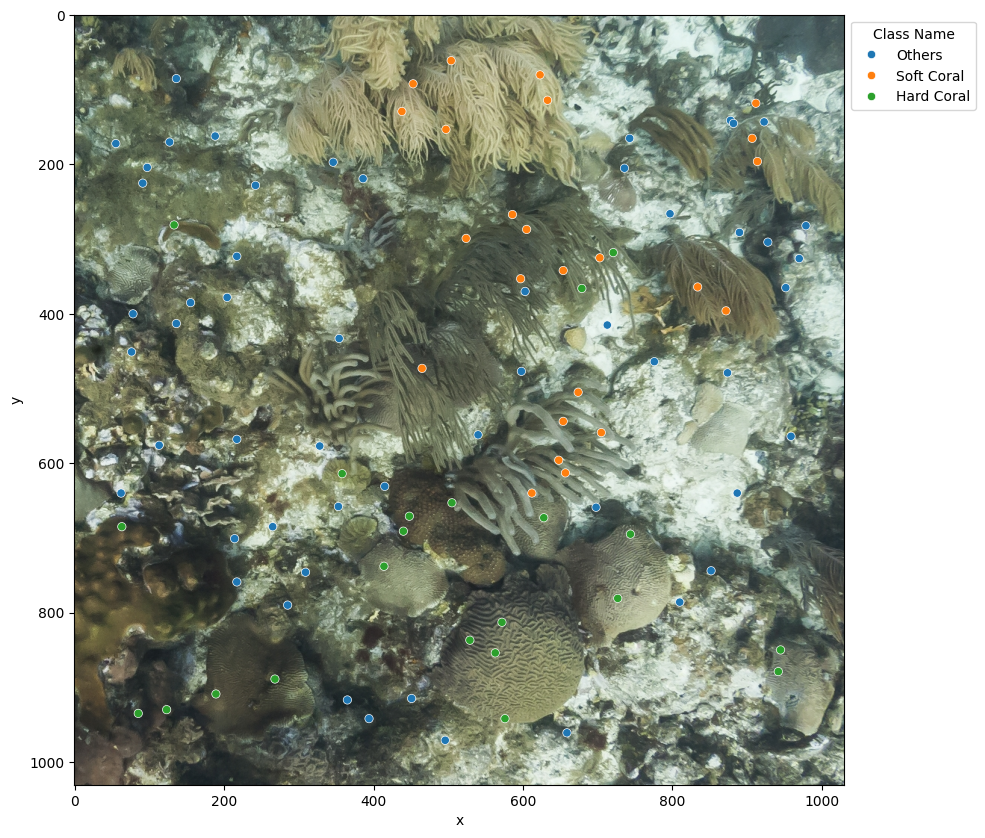

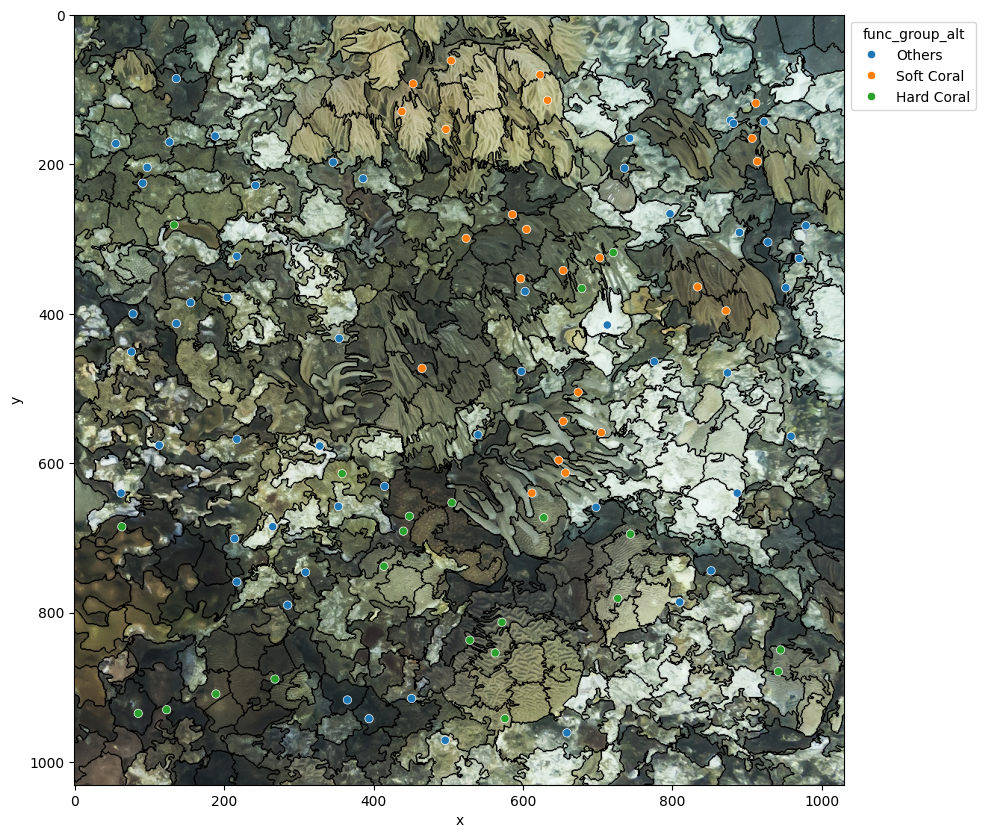

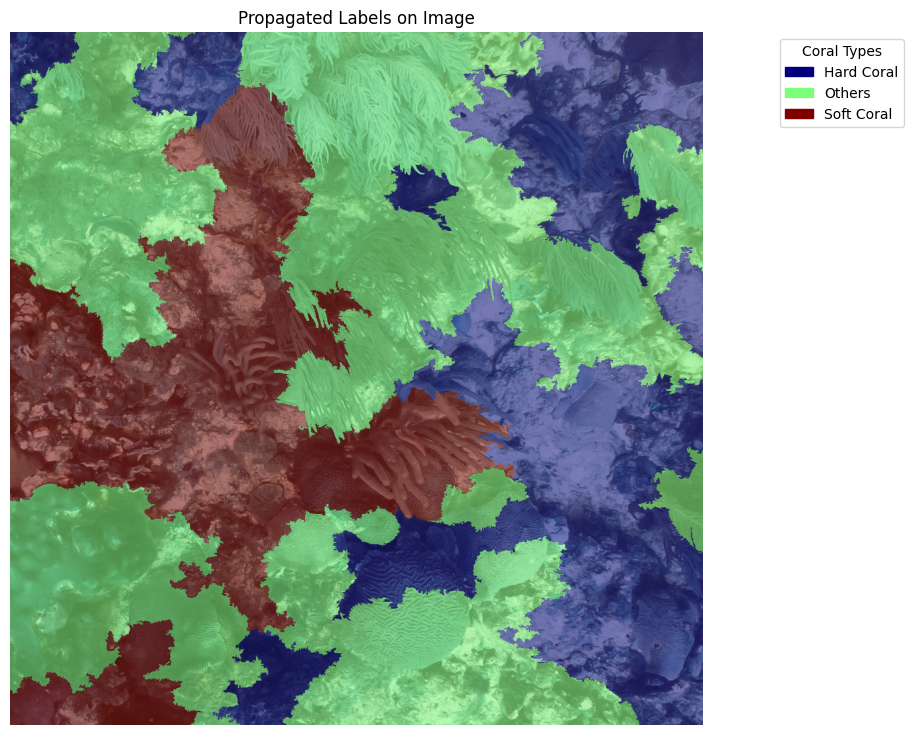

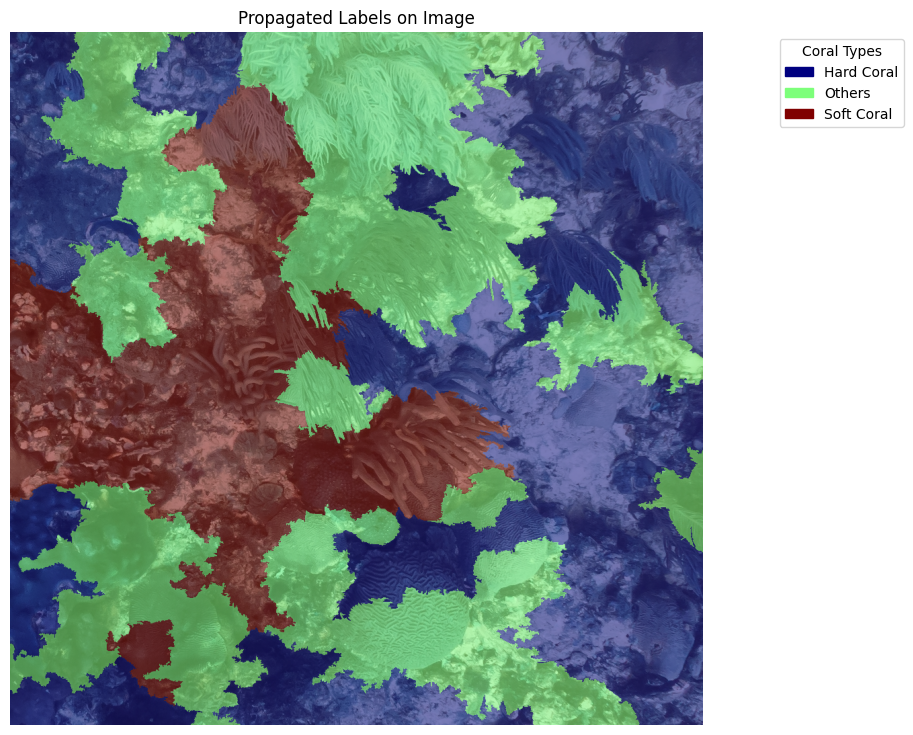

In [42]:
import numpy as np
import cv2
import skimage.graph as graph
from skimage.segmentation import slic
from sklearn.metrics.pairwise import cosine_similarity
from scipy.sparse import csgraph
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from sklearn.preprocessing import LabelEncoder
import os

# Step 1: Load Image and Sparse Point Labels
def load_image_and_labels(image_path, point_labels):
    image = cv2.imread(image_path)
    labels = point_labels
    return image, labels  # Dictionary: key=coordinates, value=label

# Step 2: Generate Superpixels using SLIC (Simple Linear Iterative Clustering)
def generate_superpixels(image, n_segments=200):
    superpixels = slic(image, n_segments=n_segments, compactness=10)
    return superpixels

# Step 3: Assign Labels to Superpixels
def assign_labels_to_superpixels(superpixels, labels):
    superpixel_labels = np.full(superpixels.shape, -1)
    for coord, label in labels.items():
        superpixel = superpixels[coord[0], coord[1]]
        superpixel_labels[superpixels == superpixel] = label
    return superpixel_labels

# Step 4: Diffusion-Based Label Propagation
def propagate_labels_by_diffusion(superpixels, superpixel_labels, image, n_iterations=100):
    # Step 1: Create a feature matrix (e.g., mean color) for each superpixel
    num_superpixels = superpixels.max() + 1
    superpixel_features = np.zeros((num_superpixels, 3))  # 3 for RGB

    # Compute mean color features for each superpixel
    for sp in range(num_superpixels):
        mask = (superpixels == sp)

        # Check if the superpixel contains pixels
        if np.any(mask):
            superpixel_features[sp, :] = np.mean(image[mask], axis=0)
        else:
            superpixel_features[sp, :] = np.array([0, 0, 0])  # Assign a default value for empty superpixels

    # Step 2: Create an affinity matrix (using cosine similarity for color-based propagation)
    affinity_matrix = cosine_similarity(superpixel_features)

    # Step 3: Initialize known superpixel labels from sparse labels
    propagated_labels = np.full(num_superpixels, -1)
    for sp in range(num_superpixels):
        mask = (superpixels == sp)
        unique_labels = np.unique(superpixel_labels[mask])
        unique_labels = unique_labels[unique_labels != -1]
        if len(unique_labels) > 0:
            propagated_labels[sp] = unique_labels[0]  # Assign the first found label

    # Step 4: Propagate labels using diffusion-based approach
    for iteration in range(n_iterations):
        new_labels = propagated_labels.copy()
        for sp in range(num_superpixels):
            if propagated_labels[sp] == -1:  # Only propagate to unlabeled superpixels
                neighbors = np.argsort(-affinity_matrix[sp])[:5]  # Top 5 neighbors
                neighbor_labels = propagated_labels[neighbors]
                unique, counts = np.unique(neighbor_labels[neighbor_labels != -1], return_counts=True)
                if len(unique) > 0:
                    new_labels[sp] = unique[np.argmax(counts)]  # Assign most common neighbor label
        if np.array_equal(propagated_labels, new_labels):
            break  # Stop if labels stop changing
        propagated_labels = new_labels

    # Step 5: Map the superpixel-based labels back to pixel space
    dense_segmentation = np.zeros_like(superpixels)
    for sp in range(num_superpixels):
        dense_segmentation[superpixels == sp] = propagated_labels[sp]

    return dense_segmentation

# Step 5: Graph-Based Label Propagation Using Region Adjacency Graph
def propagate_labels_by_graph(superpixels, superpixel_labels, image):
    rag = graph.rag_mean_color(image, superpixels, mode='similarity')
    propagated_labels = graph.cut_threshold(superpixels, rag, 10)

    # Assigning propagated labels to regions without labels
    for region in np.unique(superpixels):
        if np.sum(superpixel_labels[superpixels == region]) == 0:
            superpixel_labels[superpixels == region] = propagated_labels[superpixels == region]

    return superpixel_labels

# Additional: Label Encoder for point labels
def encode_labels(point_labels):
    encoder = LabelEncoder()
    unique_labels = list(set(point_labels.values()))  # Unique labels in point_labels
    encoder.fit(unique_labels)

    # Encode point labels
    encoded_labels = {coord: encoder.transform([label])[0] for coord, label in point_labels.items()}

    return encoded_labels, encoder

# Visualization function with Legends
def visualize_labels_on_image_with_legend(image, propagated_labels, encoder, figsize=(9, 9)):
    # Convert the propagated labels to a color map
    color_labels = plt.cm.jet(propagated_labels / np.max(propagated_labels))[:, :, :3]  # Convert to RGB
    overlay = (color_labels * 255).astype(np.uint8)  # Scale to [0, 255]

    # Create an overlay with transparency
    alpha = 0.5  # Transparency factor
    combined_image = (alpha * overlay + (1 - alpha) * image).astype(np.uint8)

    plt.figure(figsize=figsize)  # Set figure size
    plt.imshow(combined_image)
    plt.title("Propagated Labels on Image")
    plt.axis('off')  # Hide axes

    # Filter out -1 from unique labels (unlabeled regions)
    unique_labels = np.unique(propagated_labels)
    unique_labels = unique_labels[unique_labels != -1]  # Exclude -1

    # Decode the labels back to coral names
    legend_labels = encoder.inverse_transform(unique_labels)
    colors = [plt.cm.jet(float(i) / np.max(unique_labels)) for i in unique_labels]

    # Create patches for each label
    patches = [mpatches.Patch(color=colors[i], label=legend_labels[i]) for i in range(len(unique_labels))]

    # Add the legend
    plt.legend(handles=patches, loc='upper right', bbox_to_anchor=(1.3, 1), title="Coral Types")

    plt.show()

# Example usage of the functions:
if __name__ == "__main__":
    # Path and label data (you can modify these)
    DATA_BASE_PATH = os.path.join(ROOT_PATH, '01_Data', 'benthic_datasets', 'point_labels', 'SEAVIEW')  # Update this with your correct path
    quadrat_region = \
        ANNOTATIONS_DF[ANNOTATIONS_DF.quadratid == quadrat_id].region.to_list()[0]
    quadrat_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")
    quadrat_df = \
        ANNOTATIONS_DF\
        .query(f"quadratid == {quadrat_id}")\
        [['x', 'y', 'func_group', 'func_group_alt', 'label', 'label_name', 'data_set', 'method']]
    quadrat_id = 17001652802
    image_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")

    # Load your point labels in this format
    point_labels = {(int(row['x']), int(row['y'])): row['func_group_alt'] for _, row in quadrat_df.iterrows()}  # Update this with your actual point labels

    # Encode point labels
    encoded_labels, encoder = encode_labels(point_labels)

    # Load image
    image, labels = load_image_and_labels(image_path, point_labels)

    quadrat_image = cv2.imread(quadrat_path)
    quadrat_image = cv2.cvtColor(quadrat_image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 10))
    plt.imshow(quadrat_image)
    ax = sns.scatterplot(data=quadrat_df, x='x', y='y', hue='func_group_alt')
    sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1), title='Class Name')
    plt.show()


    # Step 2: Generate superpixels
    superpixels = generate_superpixels(image, n_segments=150)

    # Plot the image with the superpixel boundaries
    # Visualize superpixels with boundaries only (no color filling)
    segmented_image_with_boundaries = mark_boundaries(image_rgb, segments, color=(0, 0, 0), mode='inner')  # `color` sets the boundary color (white here)
    plt.figure(figsize=(10, 10))
    plt.imshow(segmented_image_with_boundaries)
    ax = sns.scatterplot(data=quadrat_df, x='x', y='y', hue='func_group_alt')
    sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1))
    plt.show()


    # Step 3: Assign labels to superpixels
    superpixel_labels = assign_labels_to_superpixels(superpixels, encoded_labels)


    # Step 4 (Option 1): Propagate labels using diffusion-based method
    propagated_labels_diffusion = propagate_labels_by_diffusion(superpixels, superpixel_labels, image)


    # Step 4 (Option 2): Propagate labels using graph-based method
    propagated_labels_graph = propagate_labels_by_graph(superpixels, superpixel_labels, image)

    # Step 5: Visualize the labels on the image (choose either graph-based or diffusion-based result)
    visualize_labels_on_image_with_legend(image, propagated_labels_diffusion, encoder)
    # Or for graph-based propagation result:
    visualize_labels_on_image_with_legend(image, propagated_labels_graph, encoder)


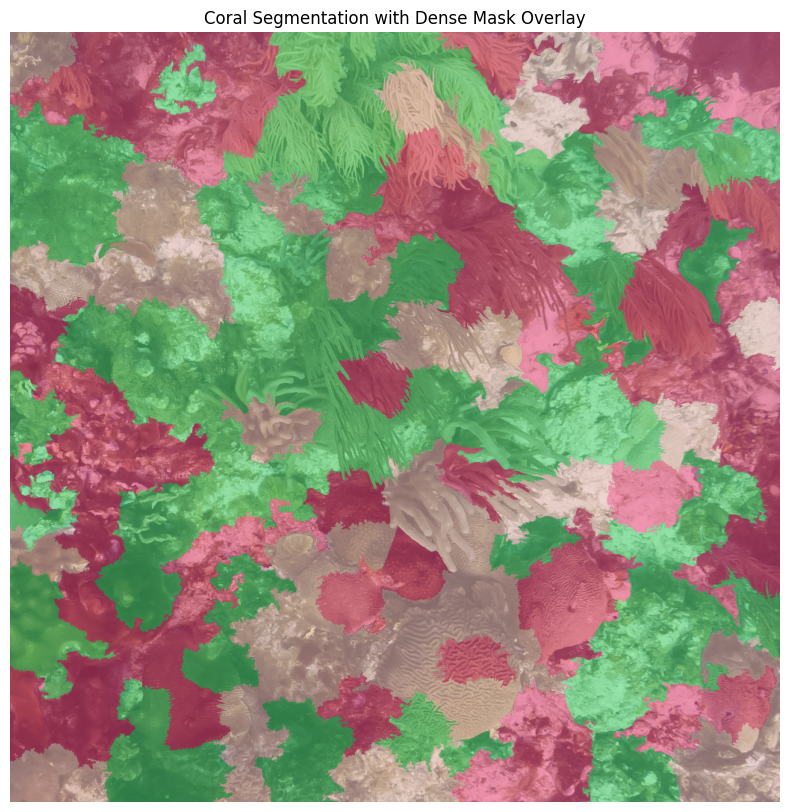

In [47]:
import numpy as np
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from skimage.segmentation import slic
from skimage import graph
from skimage.color import rgb2lab
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from skimage.filters import sobel
from skimage import feature

# Superpixel Generation
def generate_superpixels(image, num_segments=200, compactness=20):
    superpixels = slic(image, n_segments=num_segments, compactness=compactness, start_label=0)
    return superpixels

# Feature Extraction (Adding Texture and Color Features)
def extract_superpixel_features(image, superpixels):
    """
    Enhanced feature extraction method for coral reef images.
    It extracts color, texture, and edge features from each superpixel.

    Parameters:
    - image: Input image (RGB).
    - superpixels: Superpixel segmentation map of the image.

    Returns:
    - features: A matrix where each row represents the features of a superpixel.
    """
    # Step 1: Color Features (LAB)
    num_superpixels = np.max(superpixels) + 1
    lab_img = rgb2lab(image)

    # Initialize the feature matrix
    features = np.zeros((num_superpixels, 9))  # 9 feature dimensions

    # Step 2: Texture Features (Local Binary Patterns)
    gray_img = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    lbp = local_binary_pattern(gray_img, P=8, R=1, method='uniform')

    # Step 3: Edge Features (Sobel Operator)
    edges = sobel(gray_img)

    # Step 4: Extract features per superpixel
    for i in range(num_superpixels):
        mask = superpixels == i

        features[i, 0:3] = np.mean(lab_img[mask], axis=0)  # Mean LAB color
        lbp_values = lbp[mask]
        features[i, 3] = np.mean(lbp_values)
        features[i, 4] = np.var(lbp_values)

        edge_values = edges[mask]
        features[i, 5] = np.mean(edge_values)
        features[i, 6] = np.var(edge_values)

        area = np.sum(mask)
        perimeter = np.sum(feature.canny(gray_img)[mask])

        features[i, 7] = area
        features[i, 8] = perimeter

    return features

# Load Pre-trained Model
def extract_cnn_features(image):
    """
    Extract features from the input image using a pre-trained CNN (e.g., ResNet).

    Parameters:
    - image: Input image (RGB).

    Returns:
    - features: A tensor of features extracted by the CNN.
    """
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    image = preprocess(image).unsqueeze(0)  # Add batch dimension

    model = models.resnet50(pretrained=True)
    model.eval()

    with torch.no_grad():
        features = model(image)

    return features.squeeze().numpy()  # Remove batch dimension

# Combine Features for Label Propagation
def combine_features(image, superpixels):
    """
    Combine features from both superpixel extraction and CNN extraction.

    Parameters:
    - image: Input image (RGB).
    - superpixels: Superpixel segmentation map of the image.

    Returns:
    - combined_features: Combined feature matrix for superpixels.
    """
    # Extract superpixel features
    superpixel_features = extract_superpixel_features(image, superpixels)

    # Extract CNN features (single feature vector for the image)
    cnn_features = extract_cnn_features(image)

    # Combine features: replicate CNN features for each superpixel
    num_superpixels = superpixel_features.shape[0]
    cnn_features_replicated = np.tile(cnn_features, (num_superpixels, 1))

    # Combine both features
    combined_features = np.hstack((superpixel_features, cnn_features_replicated))  # Concatenate horizontally

    return combined_features

# Graph Construction
def build_superpixel_graph(image, superpixels):
    g = graph.rag_mean_color(image, superpixels)
    return g

# SSN Label Propagation with combined features
def label_propagation(graph, features, num_classes=3):
    # Use extracted features directly for label propagation
    input_dim = features.shape[1]
    hidden_dim = 128  # More hidden units
    output_dim = num_classes

    # Dummy labels for example (replace with your ground truth labels)
    labels = torch.randint(0, num_classes, (features.shape[0],))

    # Propagate labels using the dummy model (not trained)
    with torch.no_grad():
        predictions = labels  # Replace this with actual propagation logic as needed

    return predictions.numpy()

# Coral Image Segmentation using SSN
def coral_segmentation_ssn(image):
    # Step 1: Generate superpixels
    superpixels = generate_superpixels(image)

    # Step 2: Combine features from both methods
    combined_features = combine_features(image, superpixels)

    # Step 3: Build superpixel graph
    g = build_superpixel_graph(image, superpixels)

    # Step 4: Perform label propagation
    labels = label_propagation(g, combined_features)

    # Step 5: Map the labels back to the image and create a mask
    mask = np.zeros_like(superpixels, dtype=np.uint8)
    for i in range(np.max(superpixels) + 1):
        mask[superpixels == i] = labels[i]

    return mask, superpixels, labels

# Function to overlay mask on the original image
def overlay_mask_on_image(image, mask, alpha=0.5):
    # Generate random colors for each label
    unique_labels = np.unique(mask)
    colors = np.random.randint(0, 255, size=(len(unique_labels), 3))

    # Create a color mask
    color_mask = np.zeros_like(image)
    for i, label in enumerate(unique_labels):
        color_mask[mask == label] = colors[i]

    # Blend the color mask with the original image
    blended_image = cv2.addWeighted(image, 1 - alpha, color_mask, alpha, 0)

    return blended_image

# Load your coral image
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Perform segmentation using SSN
mask, _, _ = coral_segmentation_ssn(image_rgb)

# Overlay the segmentation mask on the original image
blended_image = overlay_mask_on_image(image_rgb, mask)

# Display the result
plt.figure(figsize=(10, 10))
plt.imshow(blended_image)
plt.title("Coral Segmentation with Dense Mask Overlay")
plt.axis('off')
plt.show()

#### try with pretrained weights

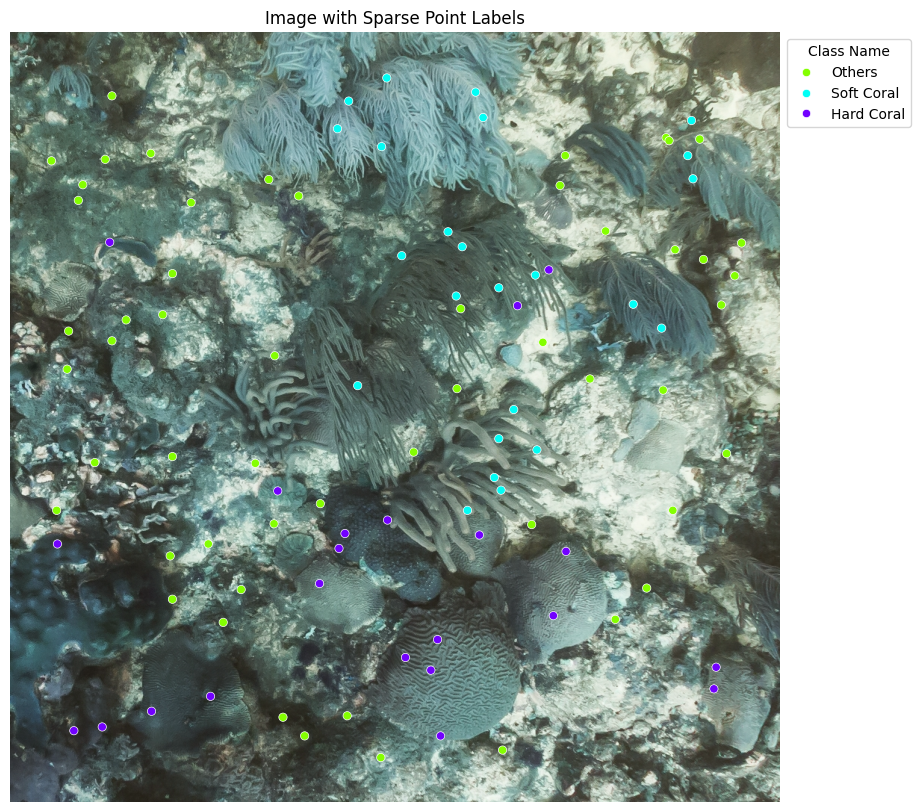

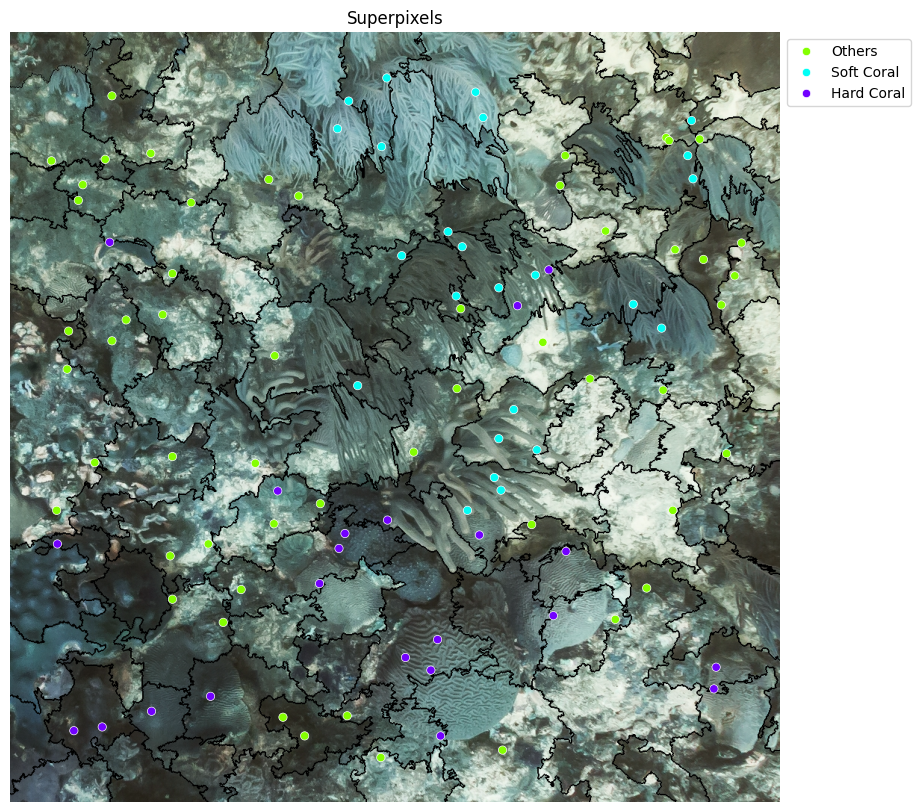

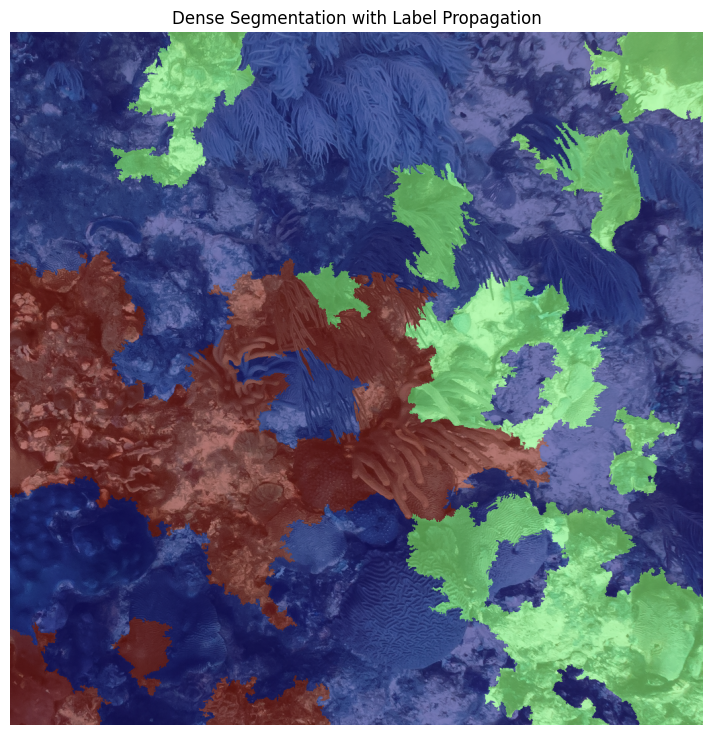

In [62]:
import numpy as np
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from skimage.segmentation import slic
from skimage import graph
from skimage.color import rgb2lab
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from skimage.filters import sobel
from skimage import feature
from skimage.segmentation import mark_boundaries
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
import os
import matplotlib.patches as mpatches
from sklearn.preprocessing import LabelEncoder

# Superpixel Generation
def generate_superpixels(image, num_segments=200, compactness=10):
    superpixels = slic(image, n_segments=num_segments, compactness=compactness, start_label=0)
    return superpixels

# Feature Extraction (Adding Texture and Color Features)
def extract_superpixel_features(image, superpixels):
    num_superpixels = np.max(superpixels) + 1
    lab_img = rgb2lab(image)

    # Initialize the feature matrix
    features = np.zeros((num_superpixels, 9))  # 9 feature dimensions

    # Texture Features (Local Binary Patterns)
    gray_img = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    lbp = local_binary_pattern(gray_img, P=8, R=1, method='uniform')

    # Edge Features (Sobel Operator)
    edges = sobel(gray_img)

    # Extract features per superpixel
    for i in range(num_superpixels):
        mask = superpixels == i

        features[i, 0:3] = np.mean(lab_img[mask], axis=0)  # Mean LAB color
        lbp_values = lbp[mask]
        features[i, 3] = np.mean(lbp_values)
        features[i, 4] = np.var(lbp_values)

        edge_values = edges[mask]
        features[i, 5] = np.mean(edge_values)
        features[i, 6] = np.var(edge_values)

        area = np.sum(mask)
        perimeter = np.sum(feature.canny(gray_img)[mask])

        features[i, 7] = area
        features[i, 8] = perimeter

    return features

# Load Pre-trained Model
def extract_cnn_features(image):
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    image = preprocess(image).unsqueeze(0)  # Add batch dimension

    model = models.resnet50(pretrained=True)
    model.eval()

    with torch.no_grad():
        features = model(image)

    return features.squeeze().numpy()  # Remove batch dimension

# Combine Features for Label Propagation
def combine_features(image, superpixels):
    superpixel_features = extract_superpixel_features(image, superpixels)
    cnn_features = extract_cnn_features(image)
    num_superpixels = superpixel_features.shape[0]
    cnn_features_replicated = np.tile(cnn_features, (num_superpixels, 1))
    combined_features = np.hstack((superpixel_features, cnn_features_replicated))
    return combined_features

# Load Image and Sparse Point Labels
def load_image_and_labels(image_path, point_labels):
    image = cv2.imread(image_path)
    labels = point_labels  # Dictionary: key=coordinates, value=label
    return image, labels

# Label Encoding Function
def encode_labels(point_labels):
    unique_labels = list(set(point_labels.values()))
    label_encoding = {label: idx for idx, label in enumerate(unique_labels)}
    encoded_labels = {coord: label_encoding[label] for coord, label in point_labels.items()}
    return encoded_labels, label_encoding

# Assign Labels to Superpixels
def assign_labels_to_superpixels(superpixels, labels):
    superpixel_labels = np.full(superpixels.shape, -1)
    for coord, label in labels.items():
        superpixel = superpixels[coord[0], coord[1]]
        superpixel_labels[superpixels == superpixel] = label
    return superpixel_labels

# Diffusion-Based Label Propagation
def propagate_labels_by_diffusion(superpixels, superpixel_labels, image, n_iterations=100):
    num_superpixels = superpixels.max() + 1
    superpixel_features = np.zeros((num_superpixels, 3))  # 3 for RGB

    # Compute mean color features for each superpixel
    for sp in range(num_superpixels):
        mask = (superpixels == sp)
        if np.any(mask):
            superpixel_features[sp, :] = np.mean(image[mask], axis=0)
        else:
            superpixel_features[sp, :] = np.array([0, 0, 0])  # Default value for empty superpixels

    # Create an affinity matrix (using cosine similarity for color-based propagation)
    affinity_matrix = cosine_similarity(superpixel_features)

    # Initialize known superpixel labels
    propagated_labels = np.full(num_superpixels, -1)
    for sp in range(num_superpixels):
        mask = (superpixels == sp)
        unique_labels = np.unique(superpixel_labels[mask])
        unique_labels = unique_labels[unique_labels != -1]
        if len(unique_labels) > 0:
            propagated_labels[sp] = unique_labels[0]

    # Propagate labels using diffusion-based approach
    for iteration in range(n_iterations):
        new_labels = propagated_labels.copy()
        for sp in range(num_superpixels):
            if propagated_labels[sp] == -1:
                neighbors = np.argsort(-affinity_matrix[sp])[:5]  # Top 5 neighbors
                neighbor_labels = propagated_labels[neighbors]
                unique, counts = np.unique(neighbor_labels[neighbor_labels != -1], return_counts=True)
                if len(unique) > 0:
                    new_labels[sp] = unique[np.argmax(counts)]  # Assign most common neighbor label
        if np.array_equal(propagated_labels, new_labels):
            break  # Stop if labels stop changing
        propagated_labels = new_labels

    # Map the superpixel-based labels back to pixel space
    dense_segmentation = np.zeros_like(superpixels)
    for sp in range(num_superpixels):
        dense_segmentation[superpixels == sp] = propagated_labels[sp]

    return dense_segmentation

# Visualization functions
def visualize_image_with_labels(image, point_labels, title="Image with Sparse Point Labels"):
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    ax = sns.scatterplot(x=[x for (x, y) in point_labels.keys()],
                         y=[y for (x, y) in point_labels.keys()],
                         hue=list(point_labels.values()),
                         palette='hsv')
    sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1), title='Class Name')
    plt.title(title)
    plt.axis('off')
    plt.show()

def visualize_superpixels(image, superpixels, point_labels, title="Superpixels"):
    plt.figure(figsize=(10, 10))
    segmented_image_with_boundaries = mark_boundaries(image, superpixels, color=(0, 0, 0), mode='inner')  # Black boundaries
    plt.imshow(segmented_image_with_boundaries)
    ax = sns.scatterplot(x=[x for (x, y) in point_labels.keys()],
                         y=[y for (x, y) in point_labels.keys()],
                         hue=list(point_labels.values()),
                         palette='hsv')
    sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1))
    plt.title(title)
    plt.axis('off')
    plt.show()

def visualize_labels_on_image_with_legend(image, propagated_labels, encoder, figsize=(9, 9)):
    # Convert the propagated labels to a color map
    color_labels = plt.cm.jet(propagated_labels / np.max(propagated_labels))[:, :, :3]  # Convert to RGB
    overlay = (color_labels * 255).astype(np.uint8)  # Scale to [0, 255]

    # Create an overlay with transparency
    alpha = 0.5  # Transparency factor
    combined_image = (alpha * overlay + (1 - alpha) * image).astype(np.uint8)

    plt.figure(figsize=figsize)
    plt.imshow(combined_image)
    plt.title("Dense Segmentation with Label Propagation")
    plt.axis('off')
    plt.show()

# Main Execution Flow
def main(image_path, point_labels):
    # Load image and point labels
    image, labels = load_image_and_labels(image_path, point_labels)

    # Visualize the original image with point labels
    visualize_image_with_labels(image, labels)

    # Generate superpixels
    superpixels = generate_superpixels(image)

    # Encode labels
    encoded_labels, label_encoding = encode_labels(labels)

    # Assign labels to superpixels
    superpixel_labels = assign_labels_to_superpixels(superpixels, encoded_labels)

    # Propagate labels
    dense_segmentation = propagate_labels_by_diffusion(superpixels, superpixel_labels, image)

    # Visualize superpixels and labels
    visualize_superpixels(image, superpixels, labels)
    visualize_labels_on_image_with_legend(image, dense_segmentation, label_encoding)

# Example Usage

# Path and label data (you can modify these)
quadrat_id = 17001652802
DATA_BASE_PATH = os.path.join(ROOT_PATH, '01_Data', 'benthic_datasets', 'point_labels', 'SEAVIEW')  # Update this with your correct path

quadrat_region = \
    ANNOTATIONS_DF[ANNOTATIONS_DF.quadratid == quadrat_id].region.to_list()[0]

quadrat_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")

quadrat_df = \
    ANNOTATIONS_DF\
    .query(f"quadratid == {quadrat_id}")\
    [['x', 'y', 'func_group', 'func_group_alt', 'label', 'label_name', 'data_set', 'method']]

image_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")

# Load your point labels in this format
point_labels = {(int(row['x']), int(row['y'])): row['func_group_alt'] for _, row in quadrat_df.iterrows()}  # Update this with your actual point labels


main(image_path, point_labels)


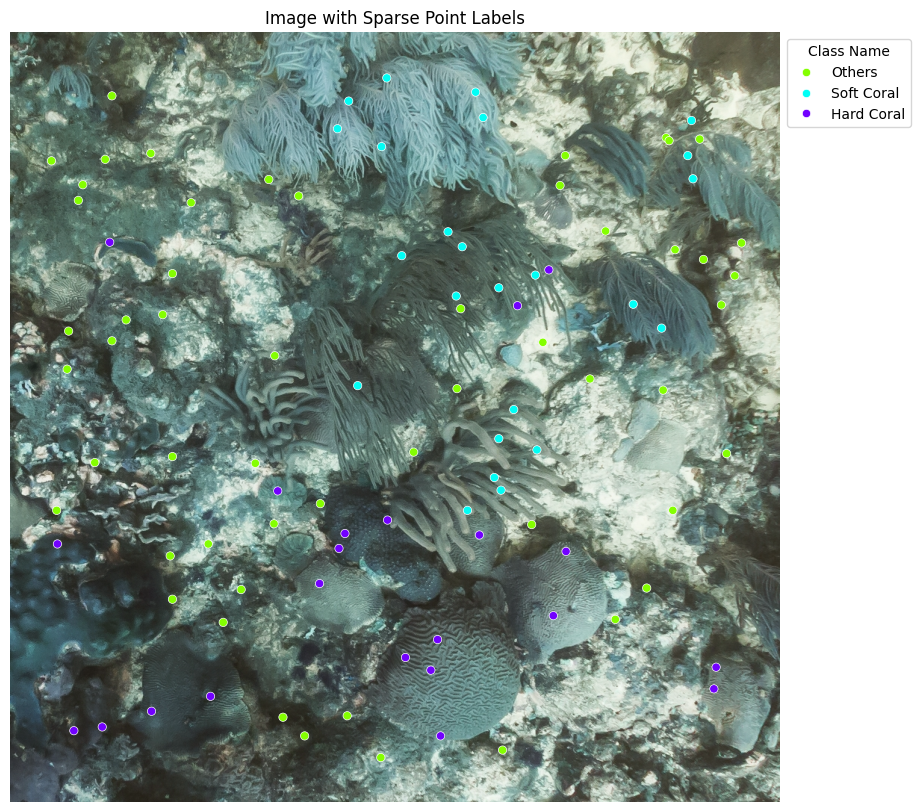

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


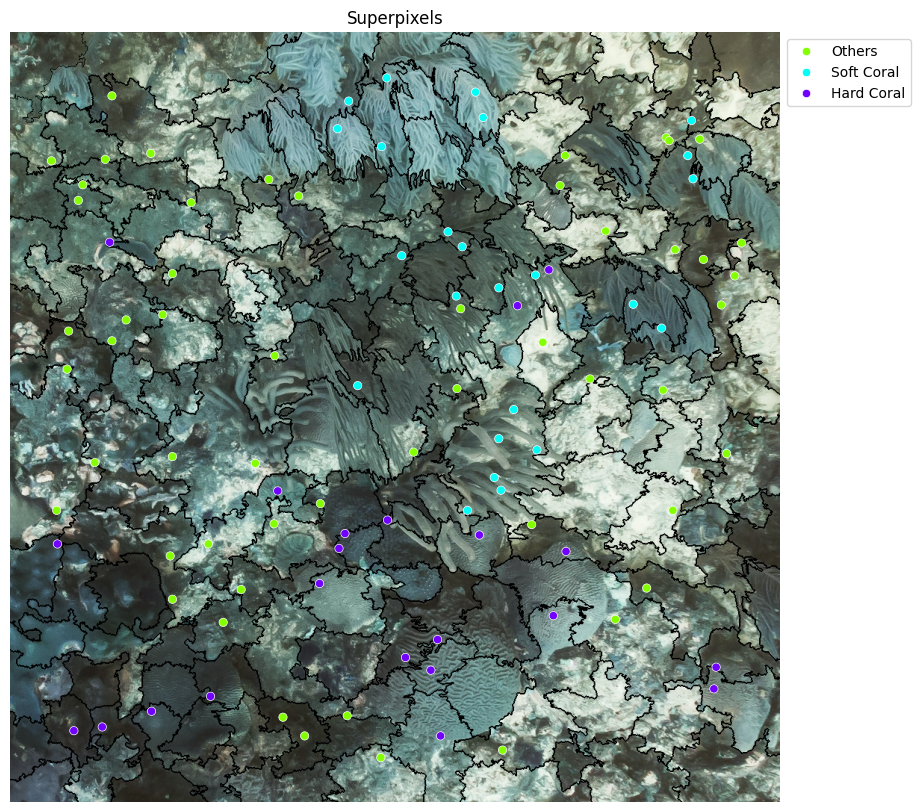

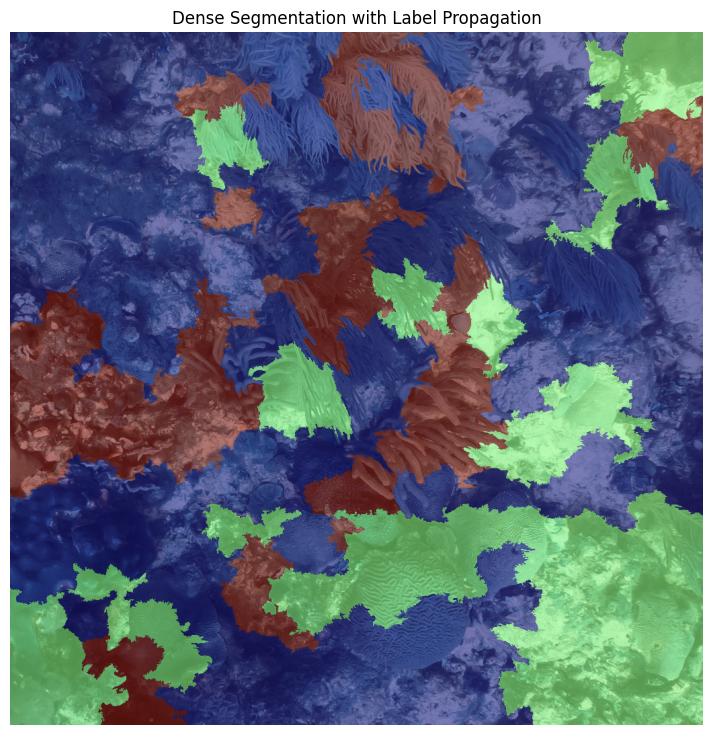

In [72]:
import numpy as np
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import models, transforms
from skimage.segmentation import slic
from skimage.color import rgb2lab
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from skimage.filters import sobel
from skimage import feature
from skimage.segmentation import mark_boundaries
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
import os
from sklearn.preprocessing import LabelEncoder

# Superpixel Generation
def generate_superpixels(image, num_segments=200, compactness=10):
    superpixels = slic(image, n_segments=num_segments, compactness=compactness, start_label=0)
    return superpixels

# Feature Extraction (Adding Texture and Color Features)
def extract_superpixel_features(image, superpixels):
    num_superpixels = np.max(superpixels) + 1
    lab_img = rgb2lab(image)

    # Initialize the feature matrix
    features = np.zeros((num_superpixels, 9))  # 9 feature dimensions

    # Texture Features (Local Binary Patterns)
    gray_img = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    lbp = local_binary_pattern(gray_img, P=8, R=1, method='uniform')

    # Edge Features (Sobel Operator)
    edges = sobel(gray_img)

    # Extract features per superpixel
    for i in range(num_superpixels):
        mask = superpixels == i

        features[i, 0:3] = np.mean(lab_img[mask], axis=0)  # Mean LAB color
        lbp_values = lbp[mask]
        features[i, 3] = np.mean(lbp_values)
        features[i, 4] = np.var(lbp_values)

        edge_values = edges[mask]
        features[i, 5] = np.mean(edge_values)
        features[i, 6] = np.var(edge_values)

        area = np.sum(mask)
        perimeter = np.sum(feature.canny(gray_img)[mask])

        features[i, 7] = area
        features[i, 8] = perimeter

    return features

# Load Pre-trained Model
def extract_cnn_features(image):
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    image = preprocess(image).unsqueeze(0)  # Add batch dimension

    model = models.resnet50(pretrained=True)
    model.eval()

    with torch.no_grad():
        features = model(image)

    return features.squeeze().numpy()  # Remove batch dimension

# Combine Features for Label Propagation
def combine_features(image, superpixels):
    superpixel_features = extract_superpixel_features(image, superpixels)
    cnn_features = extract_cnn_features(image)
    num_superpixels = superpixel_features.shape[0]
    cnn_features_replicated = np.tile(cnn_features, (num_superpixels, 1))
    combined_features = np.hstack((superpixel_features, cnn_features_replicated))
    return combined_features

# Load Image and Sparse Point Labels
def load_image_and_labels(image_path, point_labels):
    image = cv2.imread(image_path)
    labels = point_labels  # Dictionary: key=coordinates, value=label
    return image, labels

# Label Encoding Function
def encode_labels(point_labels):
    unique_labels = list(set(point_labels.values()))
    label_encoding = {label: idx for idx, label in enumerate(unique_labels)}
    encoded_labels = {coord: label_encoding[label] for coord, label in point_labels.items()}
    return encoded_labels, label_encoding

# Assign Labels to Superpixels
def assign_labels_to_superpixels(superpixels, labels):
    superpixel_labels = np.full(superpixels.shape, -1)
    for coord, label in labels.items():
        superpixel = superpixels[coord[0], coord[1]]
        superpixel_labels[superpixels == superpixel] = label
    return superpixel_labels

# label propagation
def propagate_labels_by_diffusion(superpixels, superpixel_labels, image, n_iterations=100):
    num_superpixels = superpixels.max() + 1
    combined_features = combine_features(image, superpixels)

    # Create an affinity matrix using cosine similarity
    affinity_matrix = cosine_similarity(combined_features)

    # Initialize known superpixel labels
    propagated_labels = np.full(num_superpixels, -1)
    for sp in range(num_superpixels):
        mask = (superpixels == sp)
        unique_labels = np.unique(superpixel_labels[mask])
        unique_labels = unique_labels[unique_labels != -1]
        if len(unique_labels) > 0:
            propagated_labels[sp] = unique_labels[0]

    # Propagate labels using diffusion-based approach
    for iteration in range(n_iterations):
        new_labels = propagated_labels.copy()
        for sp in range(num_superpixels):
            if propagated_labels[sp] == -1:
                # Identify neighbors based on superpixel adjacency
                neighbor_indices = np.argwhere(superpixels == sp)  # Get coordinates of pixels in current superpixel
                neighbors = set()
                # Check adjacent superpixels
                for idx in neighbor_indices:
                    # idx is now a coordinate pair [y, x]
                    y, x = idx[1], idx[0]  # Extract the y and x coordinates

                    for dx in [-1, 0, 1]:
                        for dy in [-1, 0, 1]:
                            if dx == 0 and dy == 0:
                                continue  # Skip the current superpixel itself

                            # Calculate neighbor coordinates
                            neighbor_y = min(max(y + dy, 0), superpixels.shape[1] - 1)
                            neighbor_x = min(max(x + dx, 0), superpixels.shape[0] - 1)
                            neighbor_superpixel = superpixels[neighbor_y, neighbor_x]
                            neighbors.add(neighbor_superpixel)

                neighbors = list(neighbors)

                # Use affinity matrix to weigh neighbor influence
                weighted_labels = {}
                for neighbor in neighbors:
                    if propagated_labels[neighbor] != -1:  # Only consider labeled neighbors
                        weight = affinity_matrix[sp, neighbor]
                        label = propagated_labels[neighbor]
                        if label not in weighted_labels:
                            weighted_labels[label] = 0
                        weighted_labels[label] += weight  # Accumulate weight for each label

                # Assign the label with the highest weighted sum
                if weighted_labels:
                    new_labels[sp] = max(weighted_labels, key=weighted_labels.get)

        # Stop if labels do not change
        if np.array_equal(propagated_labels, new_labels):
            break
        propagated_labels = new_labels

    # Map the superpixel-based labels back to pixel space
    dense_segmentation = np.zeros_like(superpixels)
    for sp in range(num_superpixels):
        dense_segmentation[superpixels == sp] = propagated_labels[sp]

    return dense_segmentation



# Visualization functions
def visualize_image_with_labels(image, point_labels, title="Image with Sparse Point Labels"):
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    ax = sns.scatterplot(x=[x for (x, y) in point_labels.keys()],
                         y=[y for (x, y) in point_labels.keys()],
                         hue=list(point_labels.values()),
                         palette='hsv')
    sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1), title='Class Name')
    plt.title(title)
    plt.axis('off')
    plt.show()

def visualize_superpixels(image, superpixels, point_labels, title="Superpixels"):
    plt.figure(figsize=(10, 10))
    segmented_image_with_boundaries = mark_boundaries(image, superpixels, color=(0, 0, 0), mode='inner')  # Black boundaries
    plt.imshow(segmented_image_with_boundaries)
    ax = sns.scatterplot(x=[x for (x, y) in point_labels.keys()],
                         y=[y for (x, y) in point_labels.keys()],
                         hue=list(point_labels.values()),
                         palette='hsv')
    sns.move_legend(ax, 'upper left', bbox_to_anchor=(1, 1))
    plt.title(title)
    plt.axis('off')
    plt.show()

def visualize_labels_on_image_with_legend(image, propagated_labels, encoder, figsize=(9, 9)):
    # Convert the propagated labels to a color map
    color_labels = plt.cm.jet(propagated_labels / np.max(propagated_labels))[:, :, :3]  # Convert to RGB
    overlay = (color_labels * 255).astype(np.uint8)  # Scale to [0, 255]

    # Create an overlay with transparency
    alpha = 0.5  # Transparency factor
    combined_image = (alpha * overlay + (1 - alpha) * image).astype(np.uint8)

    plt.figure(figsize=figsize)
    plt.imshow(combined_image)
    plt.title("Dense Segmentation with Label Propagation")
    plt.axis('off')
    plt.show()

# Main Execution Flow
def main(image_path, point_labels):
    # Load image and point labels
    image, labels = load_image_and_labels(image_path, point_labels)

    # Visualize the original image with point labels
    visualize_image_with_labels(image, labels)

    # Generate superpixels
    superpixels = generate_superpixels(image, num_segments=300)

    # Encode labels
    encoded_labels, label_encoding = encode_labels(labels)

    # Assign labels to superpixels
    superpixel_labels = assign_labels_to_superpixels(superpixels, encoded_labels)

    # Propagate labels
    dense_segmentation = propagate_labels_by_diffusion(superpixels, superpixel_labels, image, n_iterations=300)

    # Visualize superpixels and labels
    visualize_superpixels(image, superpixels, labels)
    visualize_labels_on_image_with_legend(image, dense_segmentation, label_encoding)

# Example Usage
# Path and label data (you can modify these)
quadrat_id = 17001652802
DATA_BASE_PATH = os.path.join(ROOT_PATH, '01_Data', 'benthic_datasets', 'point_labels', 'SEAVIEW')  # Update this with your correct path

quadrat_region = ANNOTATIONS_DF[ANNOTATIONS_DF.quadratid == quadrat_id].region.to_list()[0]
quadrat_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")

quadrat_df = ANNOTATIONS_DF.query(f"quadratid == {quadrat_id}")[['x', 'y', 'func_group', 'func_group_alt', 'label', 'label_name', 'data_set', 'method']]
image_path = os.path.join(DATA_BASE_PATH, quadrat_region, f"{quadrat_id}.jpg")

# Load your point labels in this format
point_labels = {(int(row['x']), int(row['y'])): row['func_group_alt'] for _, row in quadrat_df.iterrows()}  # Update this with your actual point labels

main(image_path, point_labels)
